# Q1) Implement logistic regression on a dataset of your choice and visualize it. 

# Solution:

Predictions:
 [1 0 0 1 1 0 0 0 1 1 1 0 1 0 1 0 1 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 1 1 1 1 0
 1 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 1 0 0 1 1 1 0 0 1 1 0 0 1 0
 1 1 1 1 1 1 0 1 1 0 0 0 0 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 0 0 1 1 1 0 1 1 0
 1 0 0]


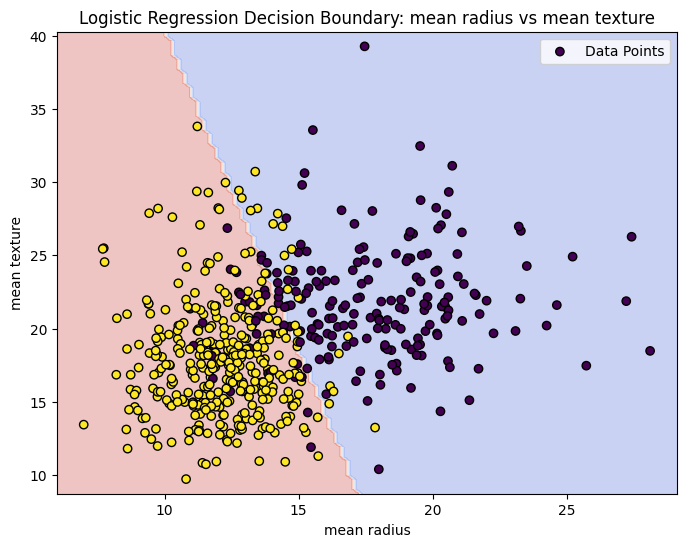

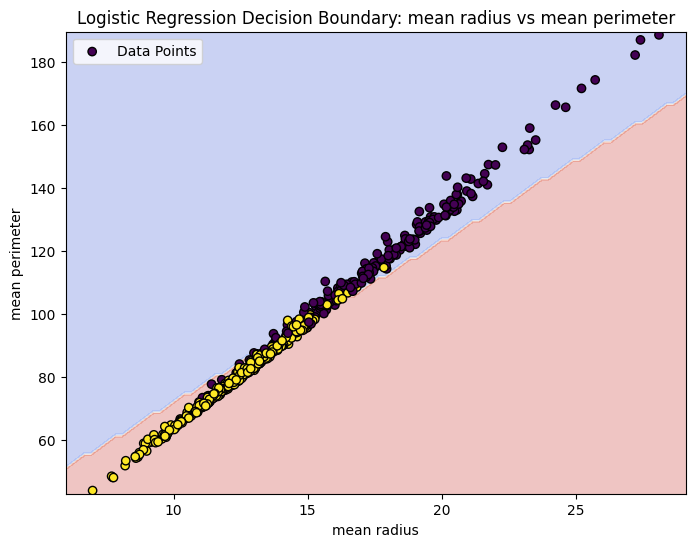

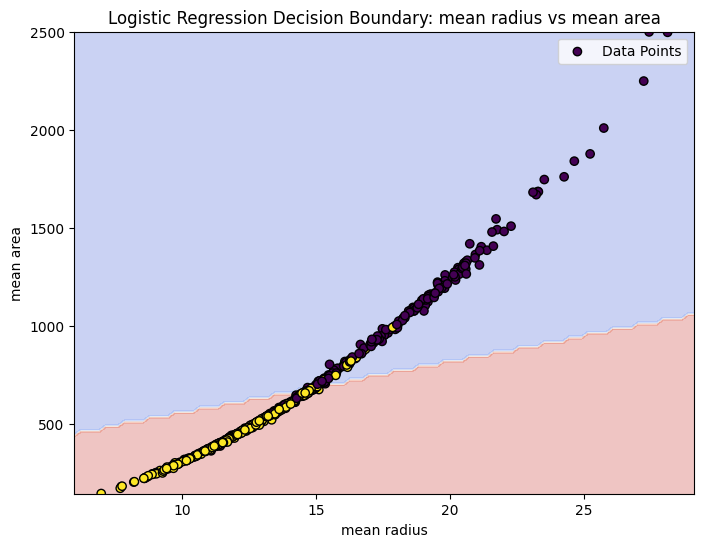

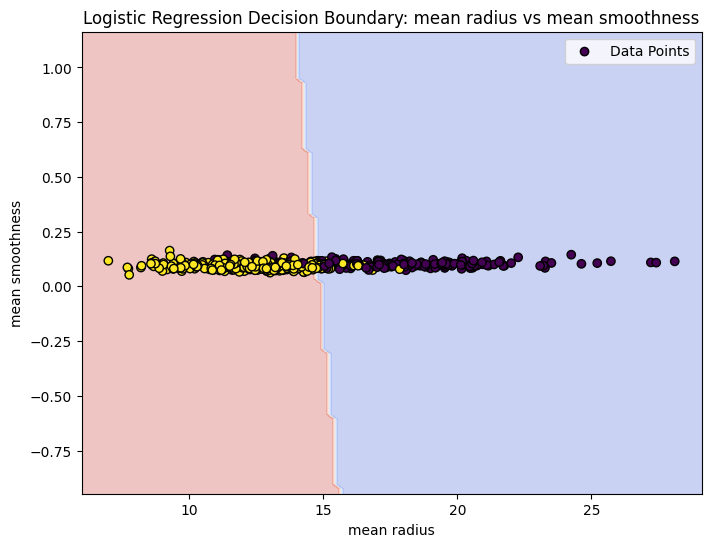

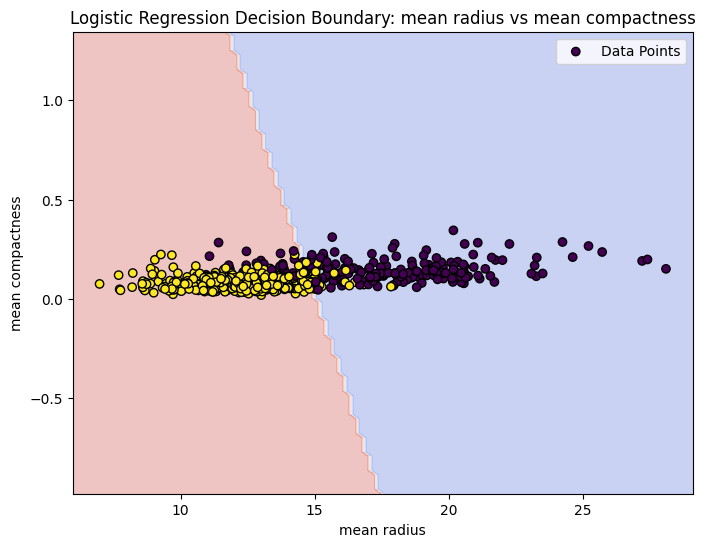

...

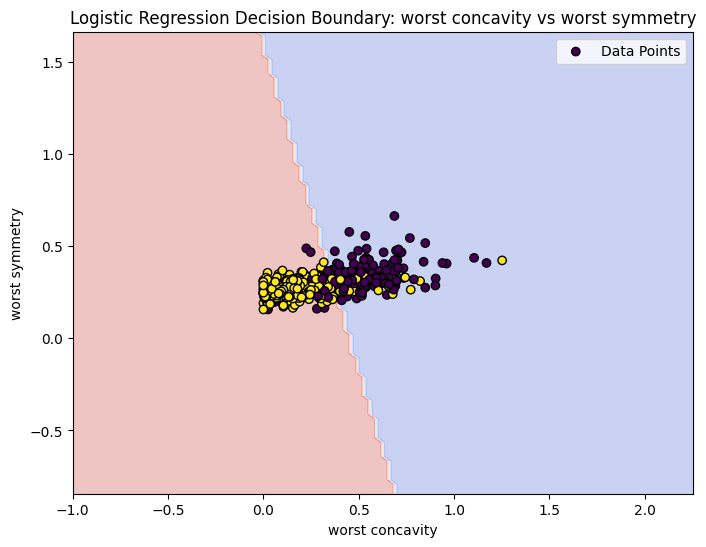

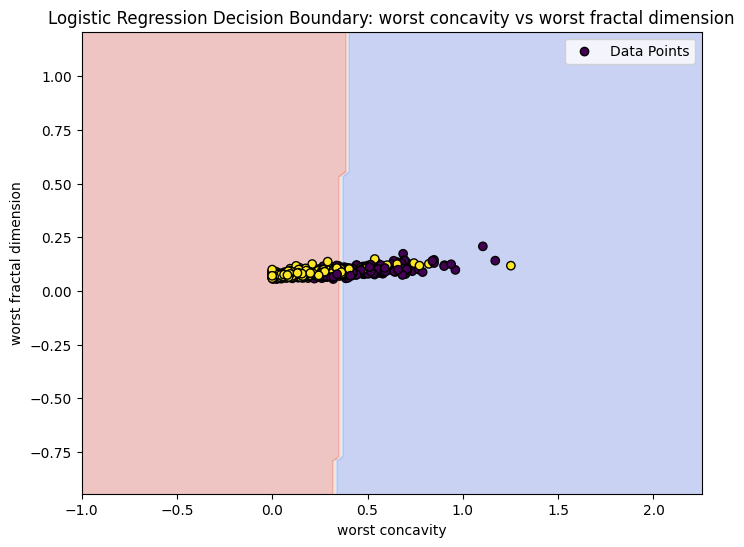

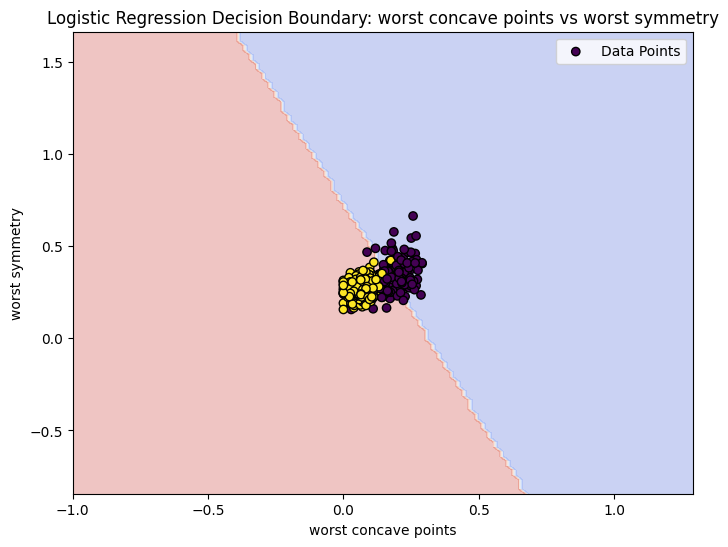

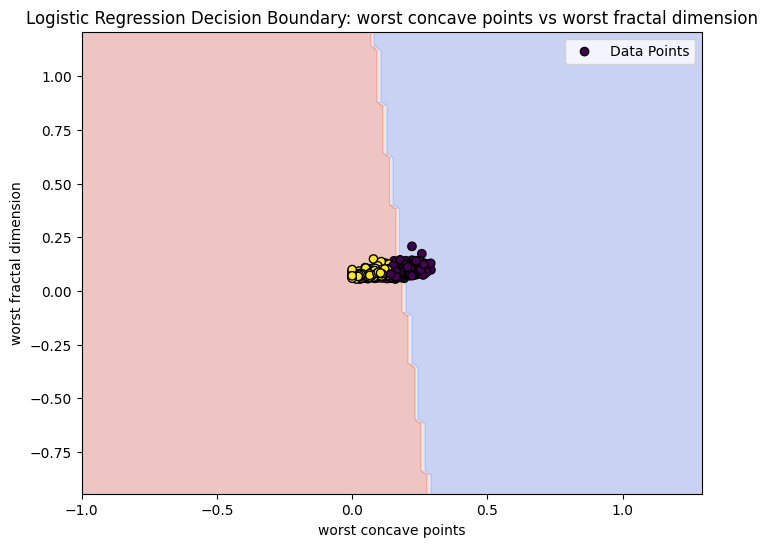

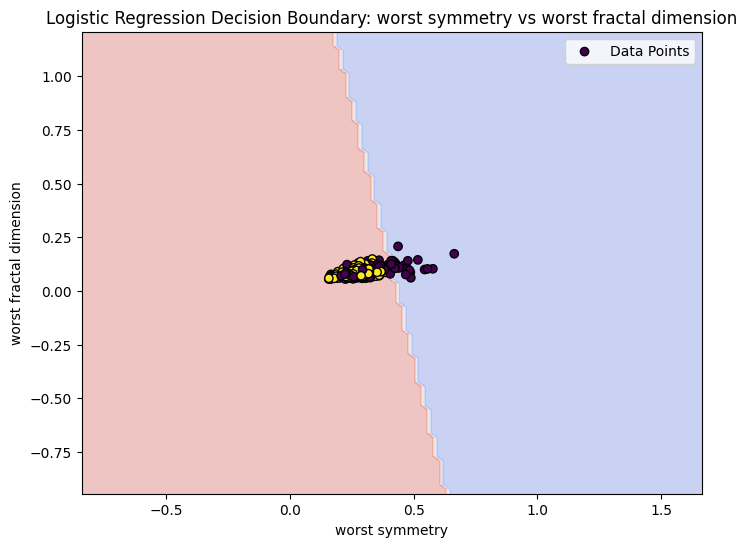

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

csv_file_path = 'breast_cancer_dataset.csv'
df = pd.read_csv(csv_file_path)

feature_names = df.columns[:-1]
X = df[feature_names].values
y = df['target'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

logistic = LogisticRegression(max_iter=10000)
logistic.fit(X_train, y_train)

predictions = logistic.predict(X_test)
print("Predictions:\n", predictions)

def plot_decision_boundary(X, y, model, ax):
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100), np.linspace(y_min, y_max, 100))
    Z = model.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    ax.contourf(xx, yy, Z, alpha=0.3, cmap='coolwarm')
    ax.scatter(X[:, 0], X[:, 1], c=y, edgecolors='k', marker='o', label='Data Points')

for i in range(len(feature_names)):
    for j in range(i + 1, len(feature_names)):
        X_pair = X[:, [i, j]]
        X_train_pair, X_test_pair, y_train_pair, y_test_pair = train_test_split(X_pair, y, test_size=0.2, random_state=42)
        logistic = LogisticRegression(max_iter=10000)
        logistic.fit(X_train_pair, y_train_pair)
        
        plt.figure(figsize=(8, 6))
        plot_decision_boundary(X_pair, y, logistic, plt.gca())
        plt.xlabel(feature_names[i])
        plt.ylabel(feature_names[j])
        plt.title(f'Logistic Regression Decision Boundary: {feature_names[i]} vs {feature_names[j]}')
        plt.legend()
        plt.show()


# Q2) Develop the cost function to determine gradient descent for logistic regression. 

# Solution:

In [5]:
import numpy as np
import pandas as pd

class LogisticRegression:
    def __init__(self, learning_rate=0.01, num_iterations=1000):
        self.learning_rate = learning_rate
        self.num_iterations = num_iterations
        self.theta = None

    def sigmoid(self, z):
        z = np.clip(z, -709, 709)
        return 1 / (1 + np.exp(-z))

    def cost_function(self, X, y):
        m = len(y)
        h = self.sigmoid(X @ self.theta)
        h = np.clip(h, 1e-10, 1 - 1e-10)
        cost = -(1 / m) * np.sum(y * np.log(h) + (1 - y) * np.log(1 - h))
        return cost

    def fit(self, X, y):
        m, n = X.shape
        self.theta = np.zeros(n)

        for iteration in range(self.num_iterations):
            h = self.sigmoid(X @ self.theta)
            gradient = (1 / m) * (X.T @ (h - y))
            self.theta -= self.learning_rate * gradient

            if iteration % 100 == 0:
                cost = self.cost_function(X, y)
                print(f'Cost at iteration {iteration}: {cost}')

    def predict(self, X):
        probabilities = self.sigmoid(X @ self.theta)
        return (probabilities >= 0.5).astype(int)

if __name__ == "__main__":
    csv_file_path = 'breast_cancer_dataset.csv'
    df = pd.read_csv(csv_file_path)

    feature_names = df.columns[:-1]
    X = df[feature_names].values
    y = df['target'].values

    X = np.hstack((np.ones((X.shape[0], 1)), X))

    model = LogisticRegression(learning_rate=0.1, num_iterations=1000)
    model.fit(X, y)

    predictions = model.predict(X)
    print("Predictions:", predictions)


Cost at iteration 0: 14.44679926539533
Cost at iteration 100: 14.36586481572981
Cost at iteration 200: 3.0412176715707706
Cost at iteration 300: 3.520648560634745
Cost at iteration 400: 2.4685007118446753
Cost at iteration 500: 2.266164587680875
Cost at iteration 600: 2.306631812949876
Cost at iteration 700: 2.525044849612019
Cost at iteration 800: 6.058525551840005
Cost at iteration 900: 2.4685007121355027
Predictions: [0 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 1 1 1 0 1 0 0 1 0 1 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0
 1 0 1 0 0 1 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 0 1 1 1 1 0 1 1 1 1 0 1 1 0 1 1
 1 1 1 1 1 1 0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 0 1 0 1 1 1 0 1 1 0 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 1 1 1 1 1 1 1 0 0 0 1 0
 1 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1 0 0 0 0 0 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 1
 1 0 1 0 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 1 1 1 1 1 0 1 0 1 1 1 1 1 0 1 0 0 

# Q3) Generate a confusion matrix and heatmap. Compute performance metrics for your model.

# Solution:

              precision    recall  f1-score   support

           0       0.97      0.91      0.94        43
           1       0.95      0.99      0.97        71

    accuracy                           0.96       114
   macro avg       0.96      0.95      0.95       114
weighted avg       0.96      0.96      0.96       114

Confusion Matrix:
[[39  4]
 [ 1 70]]


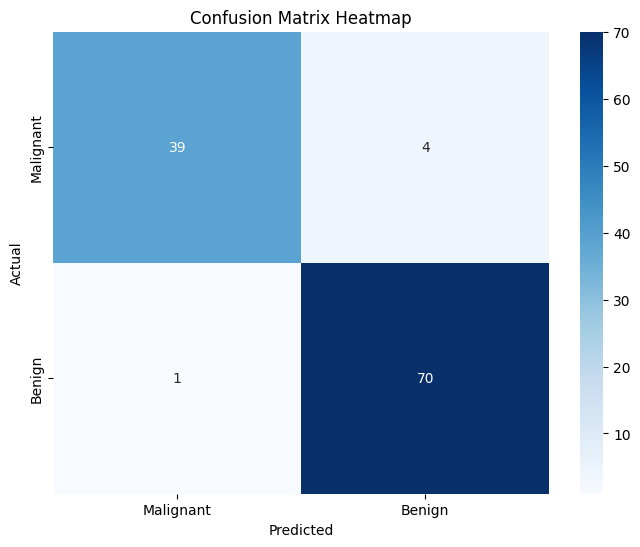

In [3]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

csv_file_path = 'breast_cancer_dataset.csv'
df = pd.read_csv(csv_file_path)

feature_names = df.columns[:-1]
X = df[feature_names]
y = df['target']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

logistic = LogisticRegression(max_iter=10000)
logistic.fit(X_train, y_train)

predictions = logistic.predict(X_test)

print(classification_report(y_test, predictions))

cm = confusion_matrix(y_test, predictions)

print("Confusion Matrix:")
print(cm)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Malignant', 'Benign'], yticklabels=['Malignant', 'Benign'])
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion Matrix Heatmap')
plt.show()
